<a href="https://colab.research.google.com/github/Koorimikiran369/LinearRegression/blob/master/HousingPrice_DataSet.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [0]:
# to get output for all printable commands (without print statement)

from IPython.core.interactiveshell import InteractiveShell
InteractiveShell.ast_node_interactivity = "all"


In [0]:
import pandas as pd
import matplotlib.pyplot as plt
from matplotlib import style
style.use('ggplot')
%matplotlib inline

import plotly
import plotly.express as px
import plotly.graph_objects as go
#plt.rcParams['figure.figsize']=17,8
import cufflinks as cf
import plotly.offline as pyo
from plotly.offline import init_notebook_mode,plot,iplot

import folium

C:\Users\kiran kumar\Anaconda3\lib\site-packages\dask\config.py:168: YAMLLoadWarning:

calling yaml.load() without Loader=... is deprecated, as the default Loader is unsafe. Please read https://msg.pyyaml.org/load for full details.

C:\Users\kiran kumar\Anaconda3\lib\site-packages\distributed\config.py:20: YAMLLoadWarning:

calling yaml.load() without Loader=... is deprecated, as the default Loader is unsafe. Please read https://msg.pyyaml.org/load for full details.



In [0]:
pyo.init_notebook_mode(connected=True)
cf.go_offline()

In [0]:
data = pd.read_csv('housing_train.csv')

data.head()

,id,url,region,region_url,price,type,sqfeet,beds,baths,cats_allowed,...,wheelchair_access,electric_vehicle_charge,comes_furnished,laundry_options,parking_options,image_url,description,lat,long,state
0,7039061606,https://bham.craigslist.org/apa/d/birmingham-h...,birmingham,https://bham.craigslist.org,1195,apartment,1908,3,2.0,1,...,0,0,0,laundry on site,street parking,https://images.craigslist.org/00L0L_80pNkyDeG0...,Apartments In Birmingham AL Welcome to 100 Inv...,33.4226,-86.7065,al
1,7041970863,https://bham.craigslist.org/apa/d/birmingham-w...,birmingham,https://bham.craigslist.org,1120,apartment,1319,3,2.0,1,...,0,0,0,laundry on site,off-street parking,https://images.craigslist.org/00707_uRrY9CsNMC...,Find Your Way to Haven Apartment Homes Come ho...,33.3755,-86.8045,al
2,7041966914,https://bham.craigslist.org/apa/d/birmingham-g...,birmingham,https://bham.craigslist.org,825,apartment,1133,1,1.5,1,...,0,0,0,laundry on site,street parking,https://images.craigslist.org/00h0h_b7Bdj1NLBi...,Apartments In Birmingham AL Welcome to 100 Inv...,33.4226,-86.7065,al
3,7041966936,https://bham.craigslist.org/apa/d/birmingham-f...,birmingham,https://bham.craigslist.org,800,apartment,927,1,1.0,1,...,0,0,0,laundry on site,street parking,https://images.craigslist.org/00808_6ghZ8tSRQs...,Apartments In Birmingham AL Welcome to 100 Inv...,33.4226,-86.7065,al
4,7041966888,https://bham.craigslist.org/apa/d/birmingham-2...,birmingham,https://bham.craigslist.org,785,apartment,1047,2,1.0,1,...,0,0,0,laundry on site,street parking,https://images.craigslist.org/00y0y_21c0FOvUXm...,Apartments In Birmingham AL Welcome to 100 Inv...,33.4226,-86.7065,al


In [0]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 265190 entries, 0 to 265189
Data columns (total 22 columns):
id                         265190 non-null int64
url                        265190 non-null object
region                     265190 non-null object
region_url                 265190 non-null object
price                      265190 non-null int64
type                       265190 non-null object
sqfeet                     265190 non-null int64
beds                       265190 non-null int64
baths                      265190 non-null float64
cats_allowed               265190 non-null int64
dogs_allowed               265190 non-null int64
smoking_allowed            265190 non-null int64
wheelchair_access          265190 non-null int64
electric_vehicle_charge    265190 non-null int64
comes_furnished            265190 non-null int64
laundry_options            210879 non-null object
parking_options            170055 non-null object
image_url                  265190 non-null objec

In [0]:
df = data.copy()

In [0]:
round(100*(df.isnull().sum()/len(df.index)),1)

id                          0.0
url                         0.0
region                      0.0
region_url                  0.0
price                       0.0
type                        0.0
sqfeet                      0.0
beds                        0.0
baths                       0.0
cats_allowed                0.0
dogs_allowed                0.0
smoking_allowed             0.0
wheelchair_access           0.0
electric_vehicle_charge     0.0
comes_furnished             0.0
laundry_options            20.5
parking_options            35.9
image_url                   0.0
description                 0.0
lat                         0.5
long                        0.5
state                       0.0
dtype: float64

In [0]:
df = df[df.isnull().sum(axis = 1) < 2]
df.shape

(214687, 22)

In [0]:
round(100*(df.isnull().sum()/ len(df.index)),2)

id                          0.00
url                         0.00
region                      0.00
region_url                  0.00
price                       0.00
type                        0.00
sqfeet                      0.00
beds                        0.00
baths                       0.00
cats_allowed                0.00
dogs_allowed                0.00
smoking_allowed             0.00
wheelchair_access           0.00
electric_vehicle_charge     0.00
comes_furnished             0.00
laundry_options             2.35
parking_options            21.13
image_url                   0.00
description                 0.00
lat                         0.00
long                        0.00
state                       0.00
dtype: float64

In [0]:
#checking NaN percentages in columns
#step-1 list of featyres with nan vaues
nan_feature = [features for features in df.columns if df[features].isnull().sum()]
#step-2 percentage of missing value
for feature in nan_feature:
    print(feature, 'has',round(100*(df[feature].isnull().sum()/len(df[feature].index)),1), '% missing values')

laundry_options has 2.3 % missing values
parking_options has 21.1 % missing values
description has 0.0 % missing values


In [0]:
for feature in nan_feature:
    df[feature] = df[feature].fillna(df[feature].value_counts().idxmax())

In [0]:
df.isnull().sum()

id                         0
url                        0
region                     0
region_url                 0
price                      0
type                       0
sqfeet                     0
beds                       0
baths                      0
cats_allowed               0
dogs_allowed               0
smoking_allowed            0
wheelchair_access          0
electric_vehicle_charge    0
comes_furnished            0
laundry_options            0
parking_options            0
image_url                  0
description                0
lat                        0
long                       0
state                      0
dtype: int64

In [0]:
cols = ['id','url','region_url','image_url','description']

df.drop(columns = cols, axis = 1, inplace = True)

In [0]:
df.head()

,region,price,type,sqfeet,beds,baths,cats_allowed,dogs_allowed,smoking_allowed,wheelchair_access,electric_vehicle_charge,comes_furnished,laundry_options,parking_options,lat,long,state
0,birmingham,1195,apartment,1908,3,2.0,1,1,1,0,0,0,laundry on site,street parking,33.4226,-86.7065,al
1,birmingham,1120,apartment,1319,3,2.0,1,1,1,0,0,0,laundry on site,off-street parking,33.3755,-86.8045,al
2,birmingham,825,apartment,1133,1,1.5,1,1,1,0,0,0,laundry on site,street parking,33.4226,-86.7065,al
3,birmingham,800,apartment,927,1,1.0,1,1,1,0,0,0,laundry on site,street parking,33.4226,-86.7065,al
4,birmingham,785,apartment,1047,2,1.0,1,1,1,0,0,0,laundry on site,street parking,33.4226,-86.7065,al


In [0]:
df_categ = df.select_dtypes(include = ['O'])
print('There is {} non numerical features including:\n{}'.format(len(df_categ.columns), df_categ.columns.tolist()))

There is 5 non numerical features including:
['region', 'type', 'laundry_options', 'parking_options', 'state']


In [0]:
num_features = [feature for feature in df.columns if df[feature].dtypes != 'O']

print('There are {}  numerical features including:\n{}'.format(len(num_features),num_features))

There are 12  numerical features including:
['price', 'sqfeet', 'beds', 'baths', 'cats_allowed', 'dogs_allowed', 'smoking_allowed', 'wheelchair_access', 'electric_vehicle_charge', 'comes_furnished', 'lat', 'long']


### Region

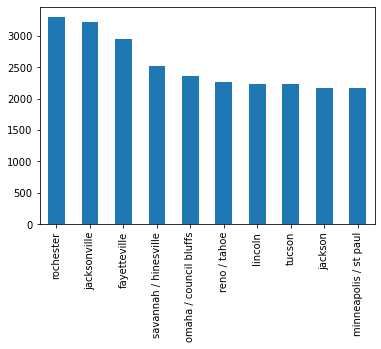

In [0]:
df['region'].value_counts().head(10).plot.bar()

### Category Columns

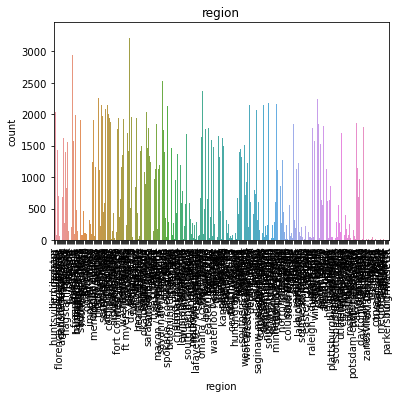

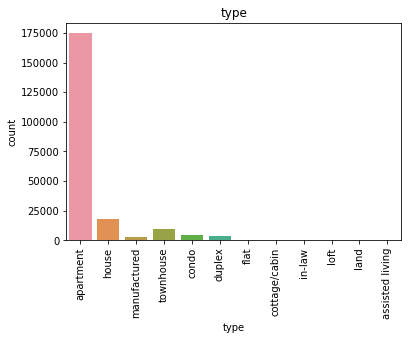

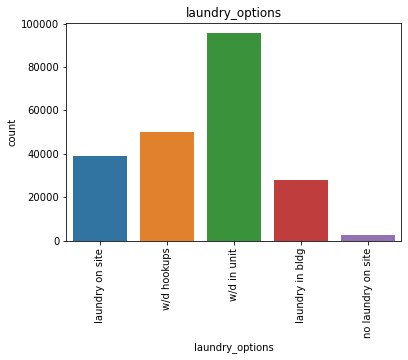

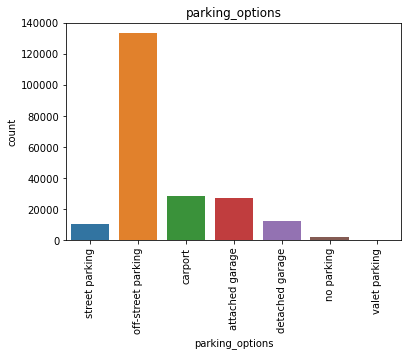

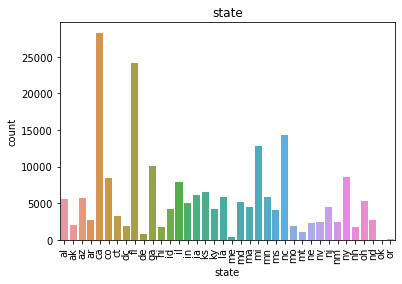

In [0]:

for feature in df_categ.columns:
    sns.countplot(x = feature,data = df_categ)
    plt.xlabel(feature)
    plt.title(feature)
    plt.xticks(rotation=90)

    plt.show()


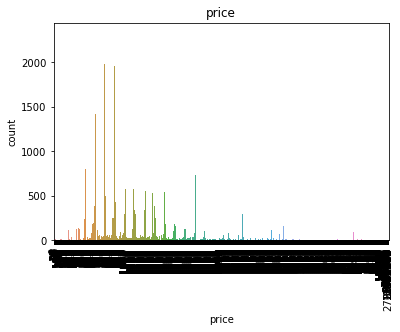

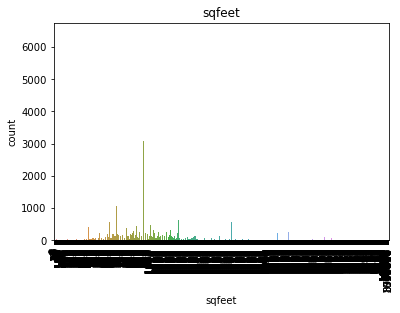

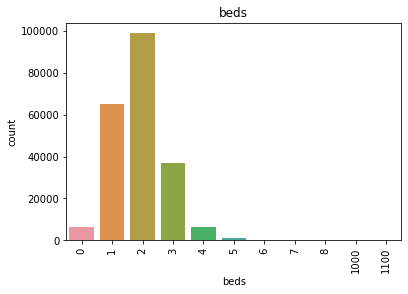

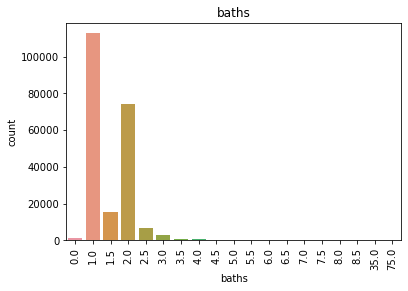

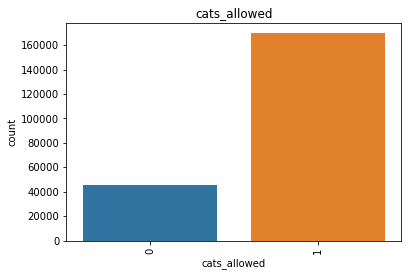

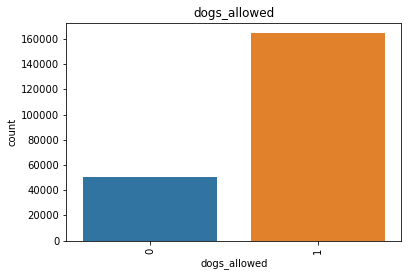

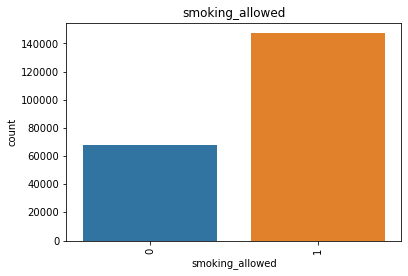

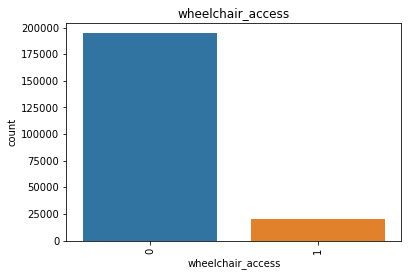

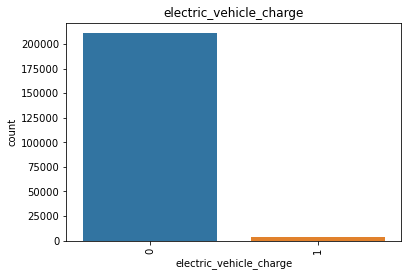

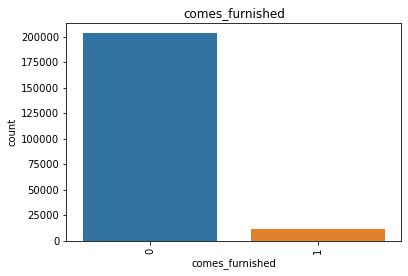

KeyboardInterrupt: 

In [0]:

for feature in df[num_features]:
    sns.countplot(x = feature,data = df[num_features])
    plt.xlabel(feature)
    plt.title(feature)
    plt.xticks(rotation=90)

    plt.show()


### Bathrooms

In [0]:
df['baths'] = round(df['baths'],0)

In [0]:
df['baths'].value_counts()

1.0     112668
2.0      96013
3.0       3146
4.0       1518
0.0       1197
5.0         92
6.0         44
7.0          3
8.0          3
75.0         2
35.0         1
Name: baths, dtype: int64

In [0]:
df.to_csv('df_final.csv')

### Bivariate Analysis

Text(0.5, 1.0, 'Average price of types')

Text(0.5, 0, 'type')

Text(0, 0.5, 'Average Price')

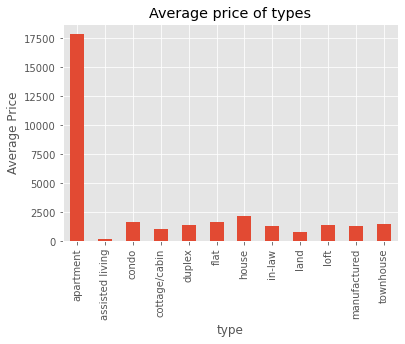

In [0]:
df_type = df.groupby('type')['price'].mean()

df_type.plot.bar()
plt.title('Average price of types')
plt.xlabel('type')
plt.ylabel('Average Price')
plt.show()



In [0]:
df.iplot(kind='bar',x='beds',y='price', title= 'Price per bedroom ',
           xTitle= 'BedRooms', yTitle= 'Price')

In [0]:
map=folium.Map(location=[10,80], zoom_start=4, tiles='Stamenterrain')

for lat,long, value, name in zip(df['lat'],df['long'],df['price'],df['region']):
    folium.CircleMarker([lat,long],
                        radius=value*0.1,popup=('<strong>State_Name</strong>: '+str(name).capitalize()+'<br>''<strong>Total_confirmed</strong>: ' + str(value)+ '<br>'),
                        color='red',fill_color='red',fill_opacity=0.3).add_to(map)
    

In [0]:
map